In [1]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import numpy as np
sc.set_figure_params(dpi=100, dpi_save=300, frameon=False, )
import shutup; shutup.please()
import matplotlib.colorbar as colorbar

In [2]:
adata = sc.read_h5ad('../Classifier/scpoli_donor_final_integration.h5ad')

In [ ]:
ref = sc.read_h5ad('../concatenated_datasets/PDAC_concat_all_genes.h5ad')
adata.obsm['X_raw_all_genes'] = ref.X
ref.obs
adata.obs_names_make_unique()
ref.obs_names_make_unique()
adata = adata[ref.obs_names, :]
ref.obs = adata.obs.copy()
ref.obsm = adata.obsm.copy()
ref.obsp = adata.obsp.copy()
ref.uns = adata.uns.copy()

adata_genes = set(adata.var_names)
ref.var['HVG_Donor_Int'] = ref.var_names.isin(adata_genes)
ref.obsm['X_umap'] = ref.obsm['X_umap_emb']
for i in ['X_cnv', 'X_cnv_pca', 'X_cnv_umap', 'X_harmony']:
    del ref.obsm[i]
pwd
ref.write('../Classifier/scpoli_donor_final_integration_all_genes.h5ad')

# re read ref

In [2]:
ref = sc.read_h5ad('../Classifier/scpoli_donor_final_integration_all_genes.h5ad')

In [3]:
ref.var["mito"] = ref.var_names.str.startswith("MT-")

In [4]:
sc.pp.normalize_total(ref, target_sum=1e4)
sc.pp.log1p(ref)

In [5]:
sc.pp.calculate_qc_metrics(ref, qc_vars=["mito"], inplace=True )

In [11]:
ref[:, ref.var.HVG_Donor_Int]

View of AnnData object with n_obs × n_vars = 837983 × 3781
    obs: 'Dataset', 'ID', 'pseudo_barcode_two', 'scanvi_labels', 'Label_Harmonized', 'conditions_combined', 'cell_type_pred', 'cell_type_uncert', 'Label_Harmonized_pred', 'Label_Harmonized_uncert', 'query', 'scpoli_labels', 'Condition', 'cell_barcode', 'Level 1 Annotation_Regev', 'Level 2 Annotation_Regev', 'Level 3 Annotation_Regev', 'Cell_type_Peng', 'Malignant Classification_Peng', 'Cell_type_Zenodo_OUGS', 'Malignant Classification_Zenodo_OUGS', 'Cell_type_Moncada', 'Malignant Classification_Moncada', 'Cell_type_Schlesinger', 'Malignant Classification_Schlesinger', 'cell_types_Ding', 'Label_Harmonized_Ding', 'Malignant_Classification_Regev', 'Malignant_Classification_Ding', 'Malignant_Classification', 'Label_Harmonized_Merged', 'Predicted_Malignant_Classification', 'Predicted_MC_Probability', 'Predicted_Malignant_Classification_emb', 'Predicted_MC_Probability_emb', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_count

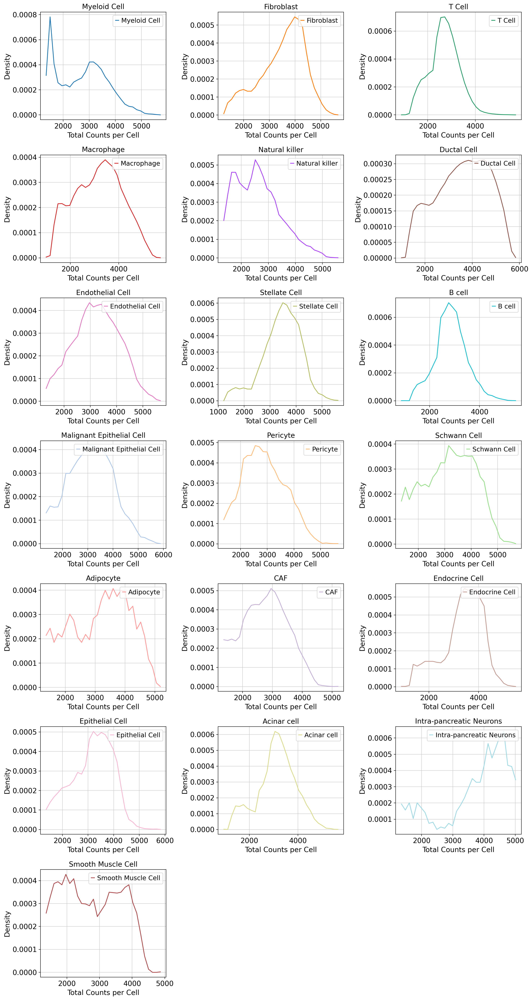

In [7]:
n_cell_types = len(cell_type)
n_cols = 3  # You can choose how many columns of subplots you want
n_rows = (n_cell_types + n_cols - 1) // n_cols  # Calculate rows needed, round up

fig, axs = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 4))  # Adjust size as needed

# Flatten the array of axes for easy iteration
axs = axs.flatten()

for idx, (ct, count_data) in enumerate(counts.items()):
    # Compute histogram data
    hist_data, bin_edges = np.histogram(count_data, bins=30, density=True)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Plot as a line on the respective subplot
    axs[idx].plot(bin_centers, hist_data, label=ct, color=colors[idx])
    axs[idx].set_xlabel('Total Counts per Cell')
    axs[idx].set_ylabel('Density')
    axs[idx].set_title(ct)
    axs[idx].legend(loc='upper right')

# Hide any unused subplots if there are any
for ax in axs[n_cell_types:]:
    ax.set_visible(False)

# Adjust the layout so labels do not overlap
plt.tight_layout()

plt.show()


In [8]:
ref.obs

,Dataset,ID,pseudo_barcode_two,scanvi_labels,Label_Harmonized,conditions_combined,cell_type_pred,cell_type_uncert,Label_Harmonized_pred,Label_Harmonized_uncert,...,Predicted_Malignant_Classification_emb,Predicted_MC_Probability_emb,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes
cell_barcode,,,,,,,,,,,,,,,,,,,,,
AAACCCAAGTCATCGT-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_1,Myeloid Cell,Unknown,Ding,Myeloid Cell,0.16665729880332947,nan,nan,...,Non-Malignant,0.004919,2929,7.982758,4075.559212,8.313009,3.379805,6.474551,11.973170,25.769326
AAACCCACAACCACGC-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_2,CAF,Unknown,Ding,Fibroblast,0.2573603689670563,nan,nan,...,Non-Malignant,0.003266,3440,8.143517,4464.634539,8.404167,2.813617,5.299524,9.879346,21.765549
AAACCCACAACTCCCT-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_3,T Cell,Unknown,Ding,T Cell,0.10481218993663788,nan,nan,...,Non-Malignant,0.001798,1976,7.589336,3461.166088,8.149650,3.933966,7.527324,14.082464,31.376152
AAACCCACAGACAATA-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_4,T Cell,Unknown,Ding,T Cell,0.16407516598701477,nan,nan,...,Non-Malignant,0.017067,2446,7.802618,3843.599536,8.254425,3.403832,6.441580,12.068995,27.108636
AAACCCACATGCCGAC-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_5,T Cell,Unknown,Ding,T Cell,0.176662877202034,nan,nan,...,Non-Malignant,0.002223,2675,7.892078,3987.315077,8.291124,3.294684,6.280408,11.773570,25.934492
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pk210318_TTTGGTTTCCGATCTC-1,Zenodo_OUGS,pk210318,annotated_cell_253801,Macrophage,Macrophage,Zenodo_OUGS,nan,nan,nan,nan,...,Non-Malignant,0.002016,743,6.612041,1982.896824,7.592818,7.196301,14.180316,27.883096,67.827779
pk210318_TTTGGTTTCCTTCACG-1,Zenodo_OUGS,pk210318,annotated_cell_253802,Macrophage,Macrophage,Zenodo_OUGS,nan,nan,nan,nan,...,Non-Malignant,0.001075,554,6.318968,1631.758484,7.398026,9.436629,18.647311,36.877034,90.371073
pk210318_TTTGTTGCAATGCAAA-1,Zenodo_OUGS,pk210318,annotated_cell_253803,T Cell,T Cell,Zenodo_OUGS,nan,nan,nan,nan,...,Non-Malignant,0.001133,1871,7.534763,3438.914378,8.143202,3.275329,6.444500,12.501411,29.460118


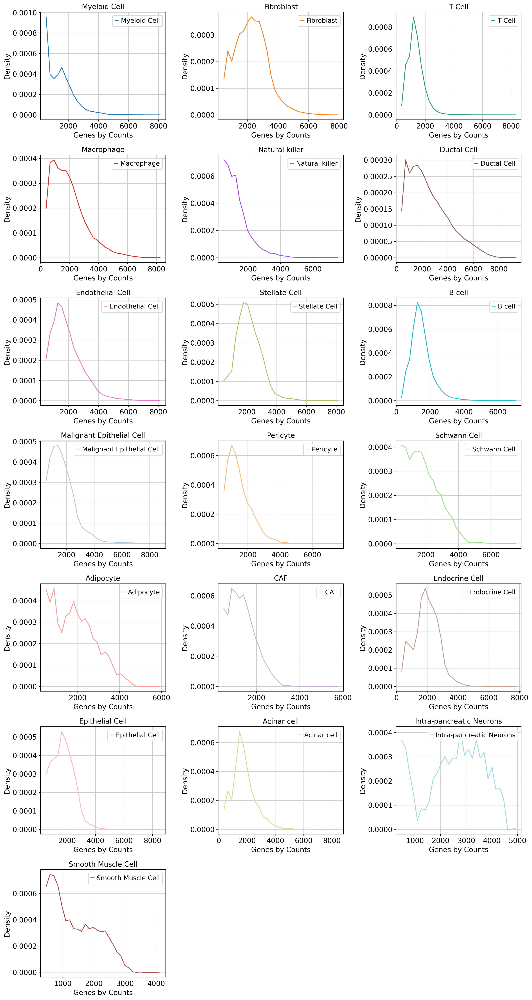

In [10]:
n_cell_types = len(cell_type)
n_cols = 3  # You can choose how many columns of subplots you want
n_rows = (n_cell_types + n_cols - 1) // n_cols  # Calculate rows needed, round up
genes_counts = {ct: subset.obs_vector("n_genes_by_counts") for ct, subset in dataset_subsets.items()}

fig, axs = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 4))  # Adjust size as needed

# Flatten the array of axes for easy iteration
axs = axs.flatten()

for idx, (ct, gene_count) in enumerate(genes_counts.items()):
    # Compute histogram data
    hist_data, bin_edges = np.histogram(gene_count, bins=30, density=True)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Plot as a line on the respective subplot
    axs[idx].plot(bin_centers, hist_data, label=ct, color=colors[idx])
    axs[idx].set_xlabel('Genes by Counts')
    axs[idx].set_ylabel('Density')
    axs[idx].set_title(ct)
    axs[idx].legend(loc='upper right')

# Hide any unused subplots if there are any
for ax in axs[n_cell_types:]:
    ax.set_visible(False)

# Adjust the layout so labels do not overlap
plt.tight_layout()

plt.show()

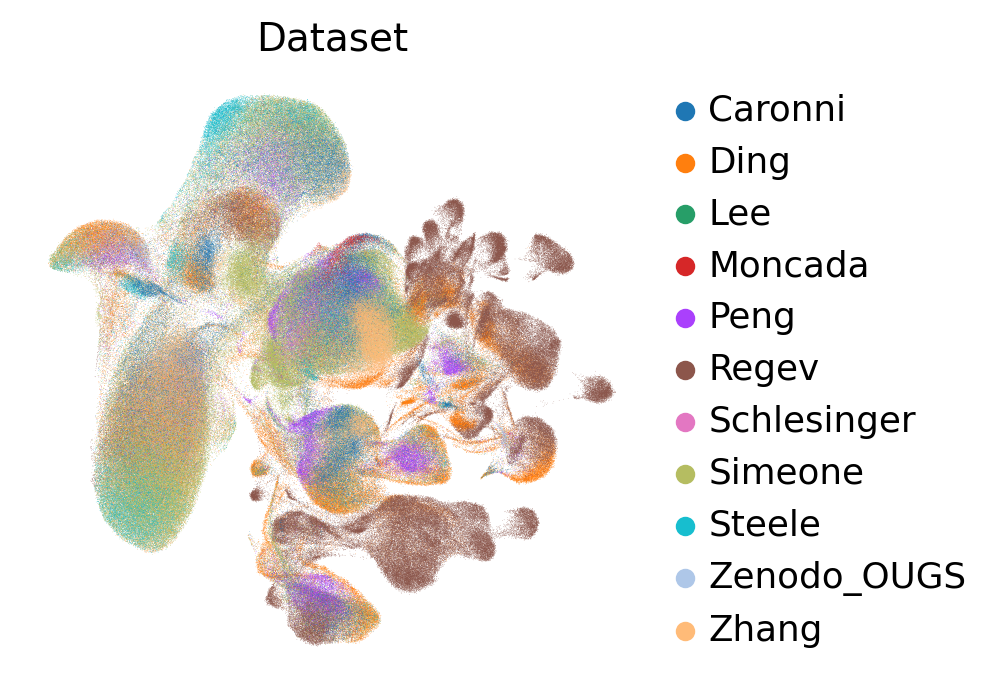

In [15]:
sc.pl.umap(adata_qc, color='Dataset', frameon=False)

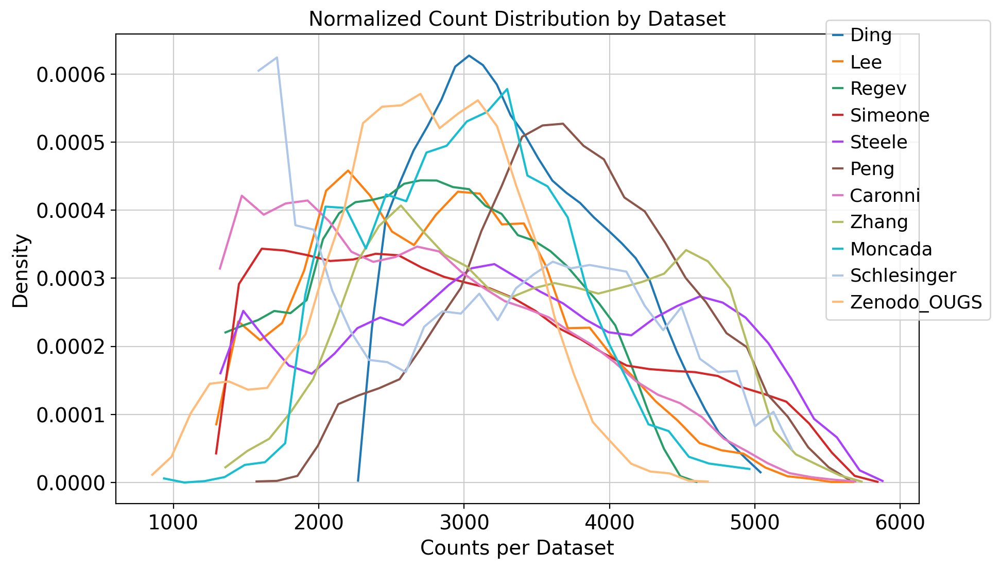

In [17]:
datasets = adata_qc.obs['Dataset'].unique()
dataset_subsets = {ct: adata_qc[adata_qc.obs['Dataset'] == ct] for ct in datasets}
counts = {ct: subset.obs_vector("total_counts") for ct, subset in dataset_subsets.items()}
fig, ax = plt.subplots(figsize=(10, 6))

colors = adata_qc.uns['Dataset_colors']

for (ds, count_data), color in zip(counts.items(), colors):
    # Compute histogram data
    hist_data, bin_edges = np.histogram(count_data, bins=30, density=True)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Plot as a line
    ax.plot(bin_centers, hist_data, label=ds, color=color)

ax.set_xlabel('Counts per Dataset')
ax.set_ylabel('Density')
ax.set_title('Normalized Count Distribution by Dataset')
ax.legend(title='Dataset')
ax.legend(bbox_to_anchor=(1.1, 1.05))

plt.show()

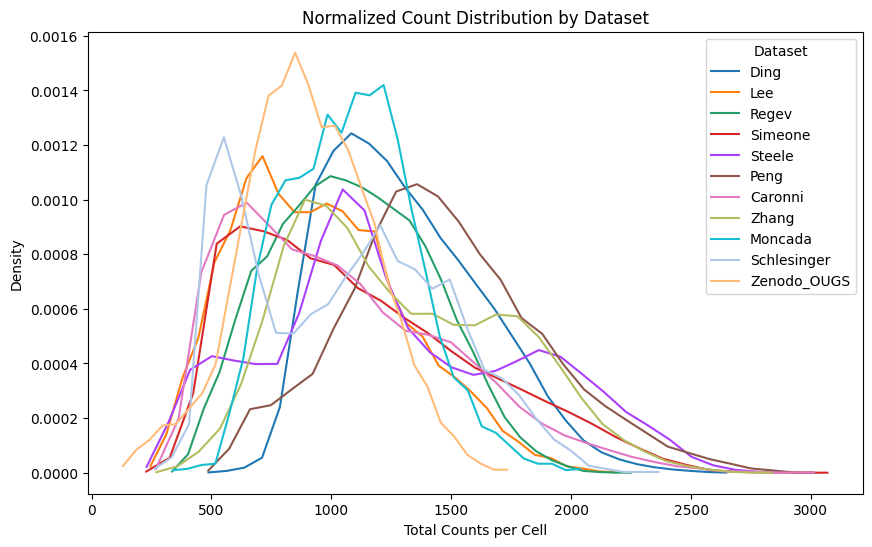

In [ ]:
# plot total count by genes
# do qc wrt to %mt to num of genes
# QC per batch and per cell type or per datasets per cell type
# check immune script from the pipeline


In [38]:
# cell_types = ref.obs.scpoli_labels.unique().tolist()
# n_cell_types = len(cell_types)
# n_cols = 3  # Define the number of columns
# n_rows = (n_cell_types + n_cols - 1) // n_cols  # Calculate the number of rows needed

# fig, axs = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 4))  # Create subplots
# axs = axs.flatten()  # Flatten the array of axes for easier indexing

# for cell, idx in zip(cell_types, range(n_cell_types)):
#     adata = ref[ref.obs.scpoli_labels == cell]
#     sc_ax = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mito", ax=axs[idx], size=10, show=False)
#     axs[idx].set_xlabel(cell)
#     norm = plt.Normalize(vmin=adata.obs['pct_counts_mito'].min(), vmax=adata.obs['pct_counts_mito'].max())
#     sm = plt.cm.ScalarMappable(cmap=sc_ax.collections[0].cmap, norm=norm)
#     sm.set_array([])
#     cbar = plt.colorbar(sm, ax=axs[idx], fraction=0.046, pad=0.04)  # Adjust fraction and pad to fit your layout
#     cbar.set_label('pct_counts_mito', rotation=270, labelpad=10)

# # Hide any unused subplots
# for ax in axs[n_cell_types:]:
#     ax.set_visible(False)

# plt.tight_layout()
# plt.show()

In [46]:
from scipy.stats import median_abs_deviation

MYELOID CELL


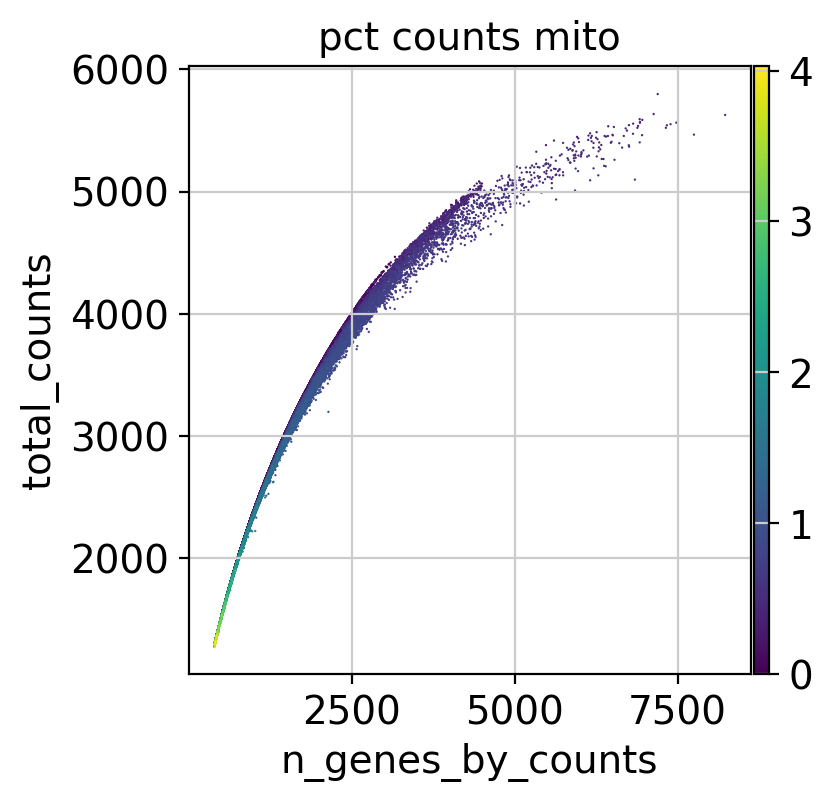

FIBROBLAST


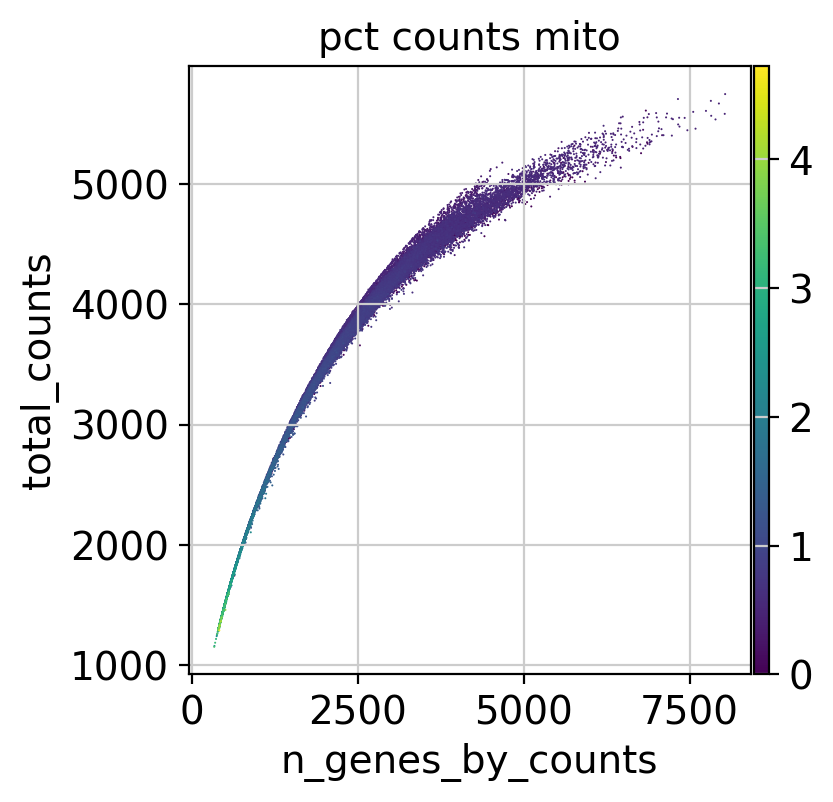

T CELL


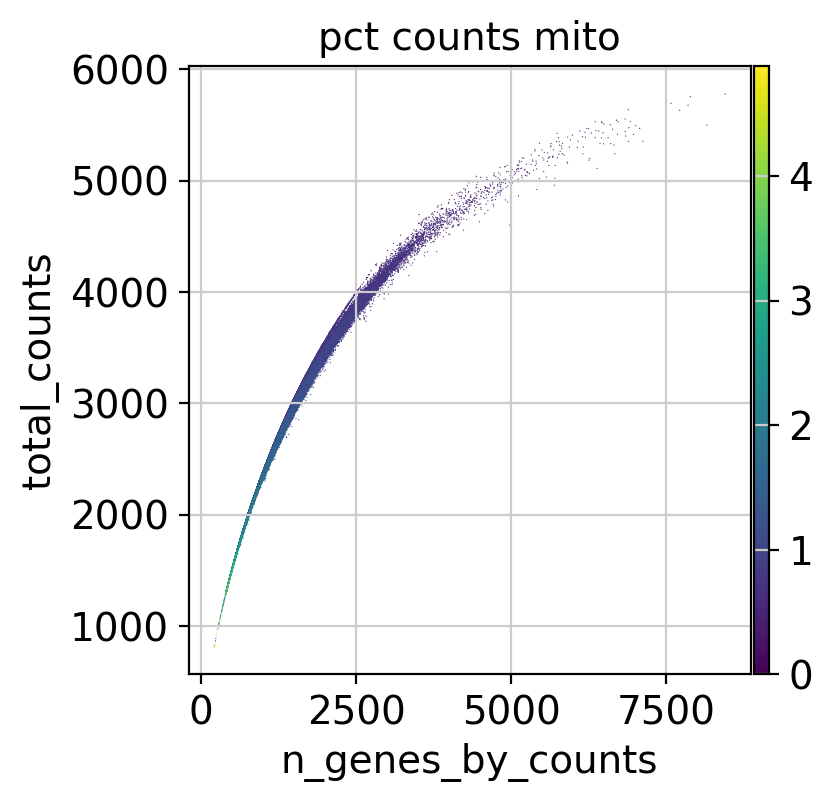

MACROPHAGE


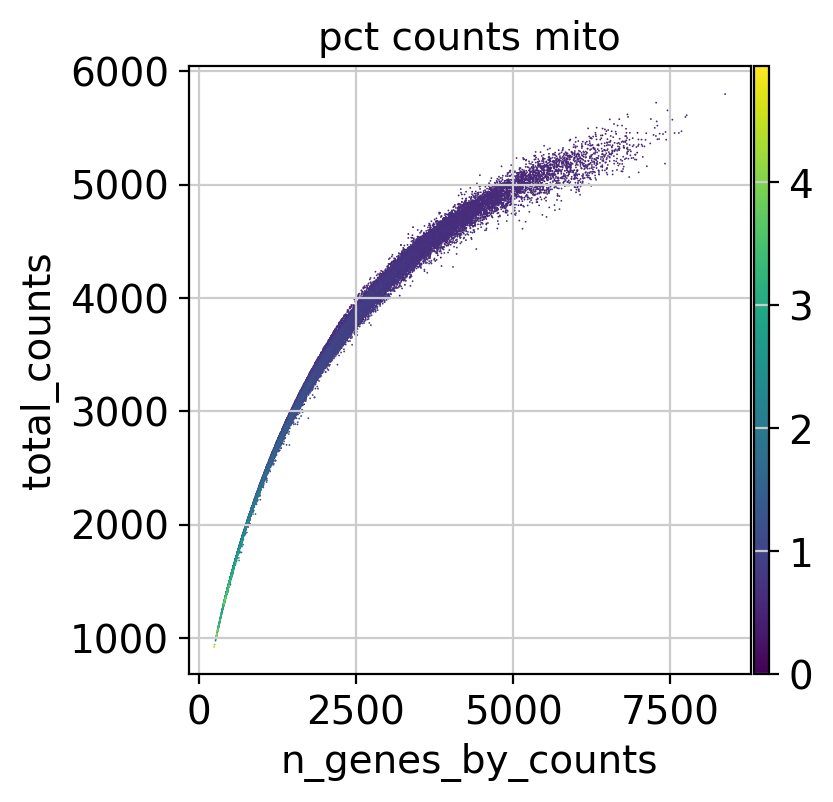

NATURAL KILLER


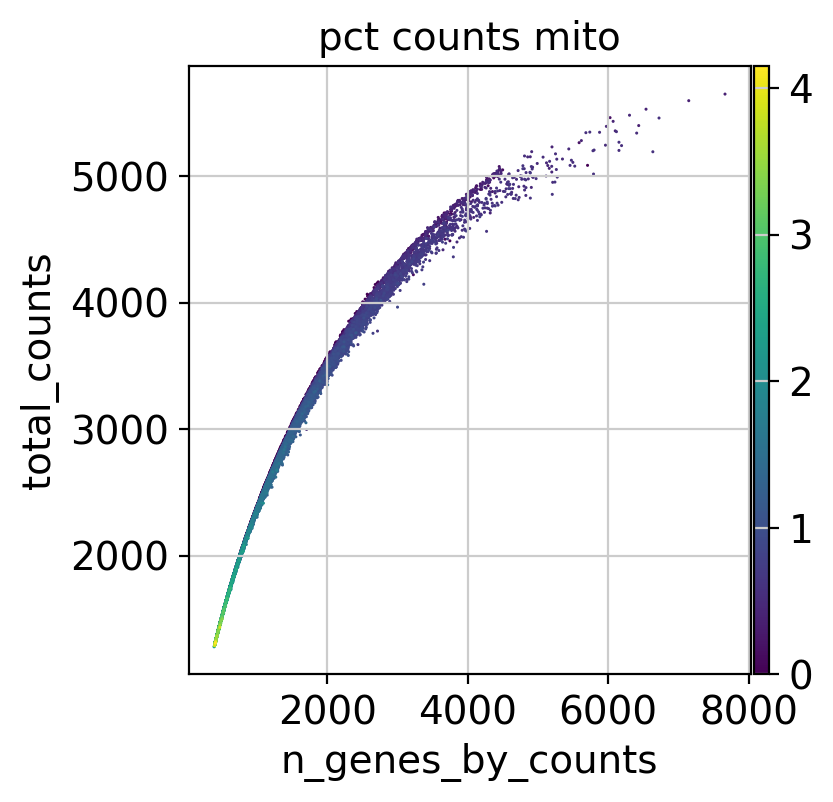

DUCTAL CELL


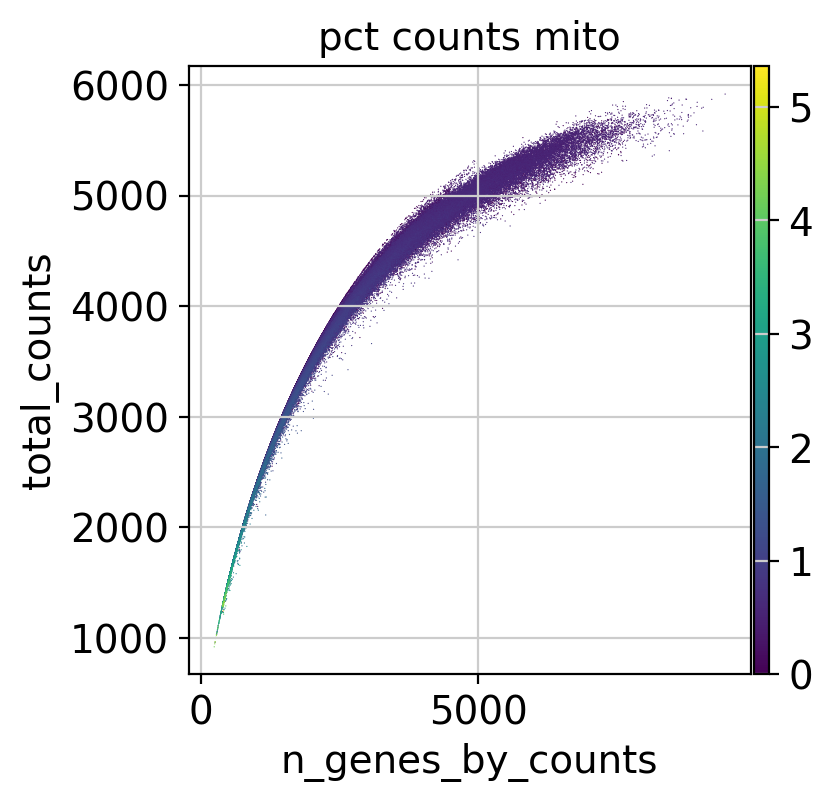

ENDOTHELIAL CELL


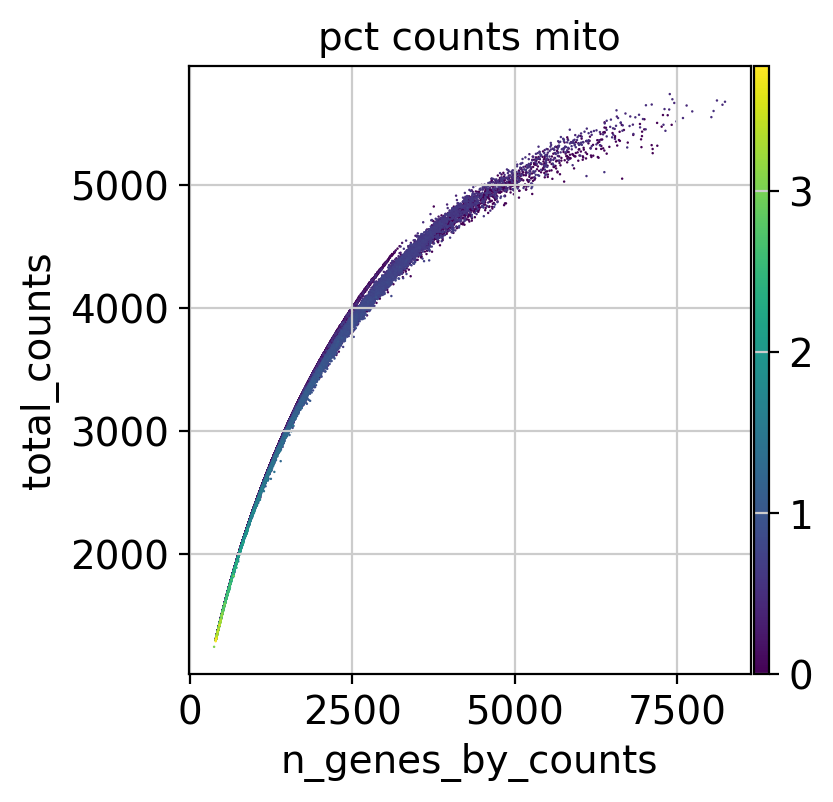

STELLATE CELL


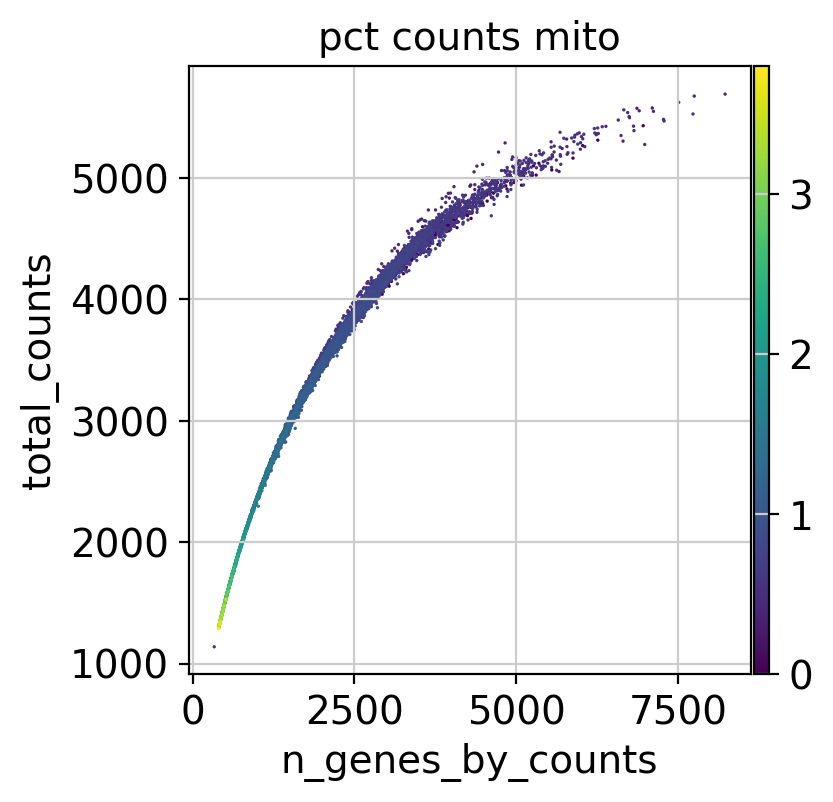

B CELL


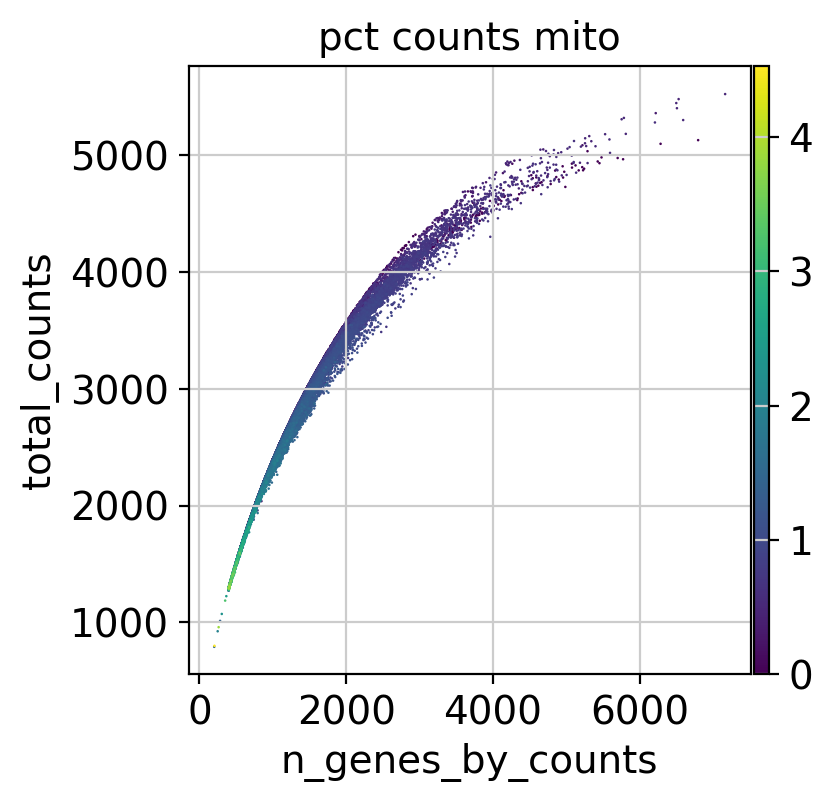

MALIGNANT EPITHELIAL CELL


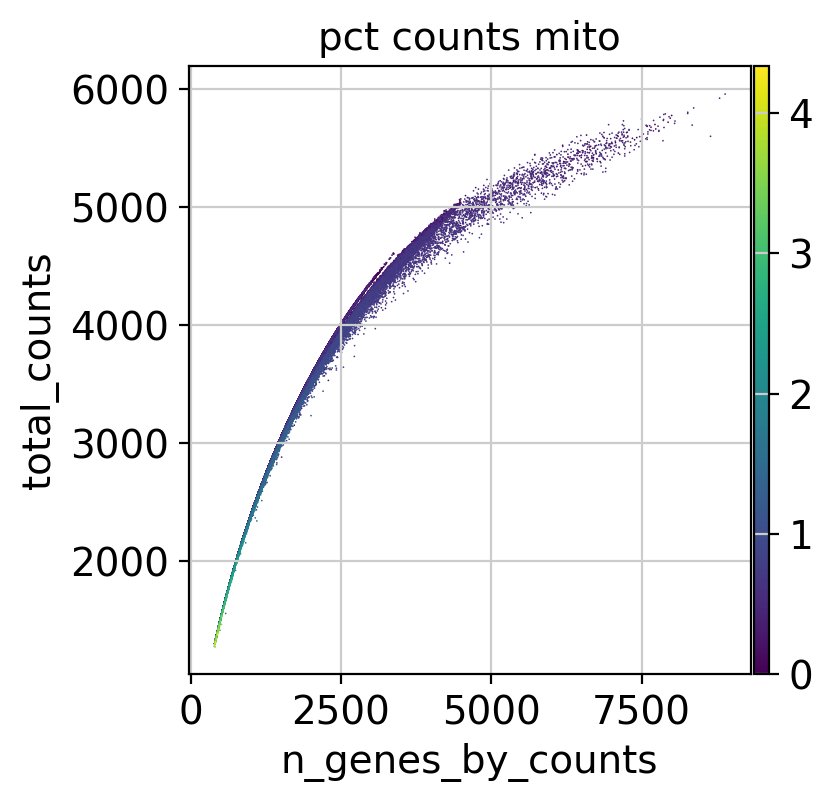

PERICYTE


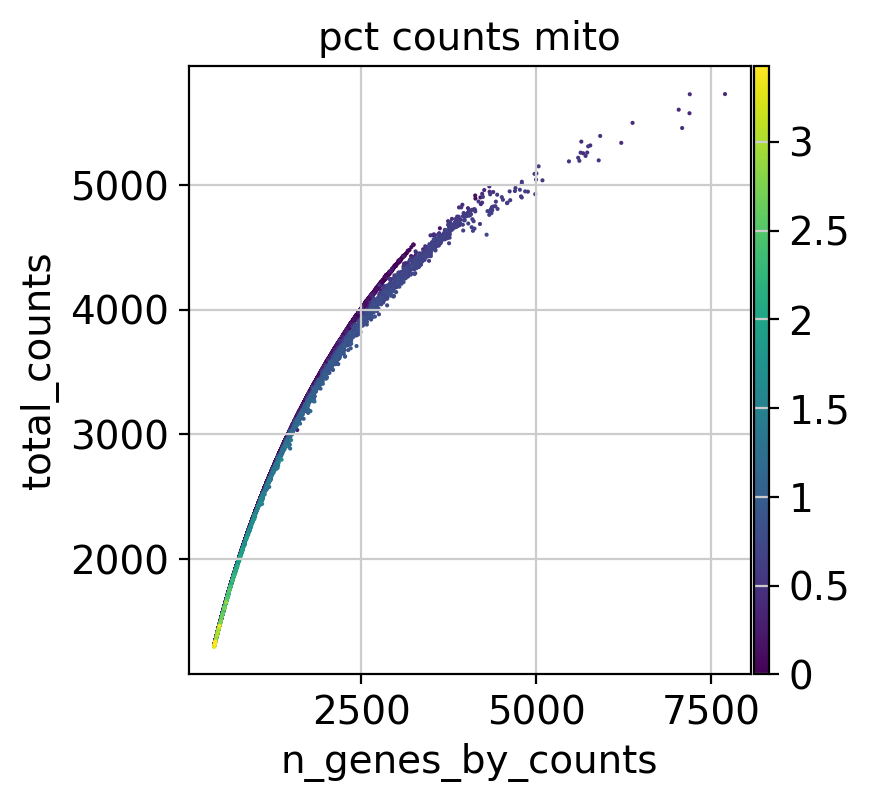

SCHWANN CELL


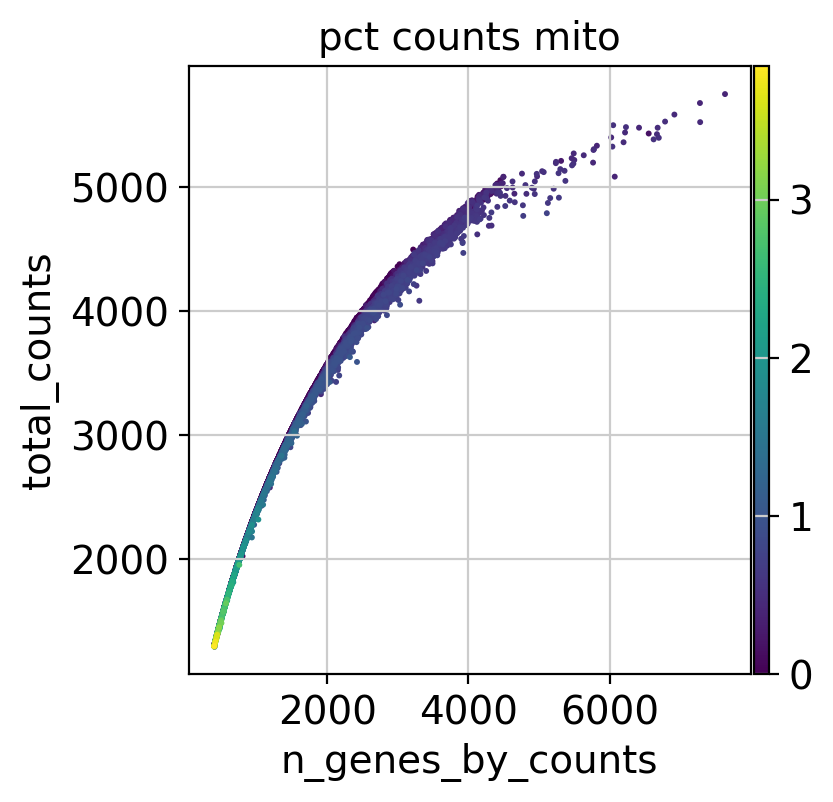

ADIPOCYTE


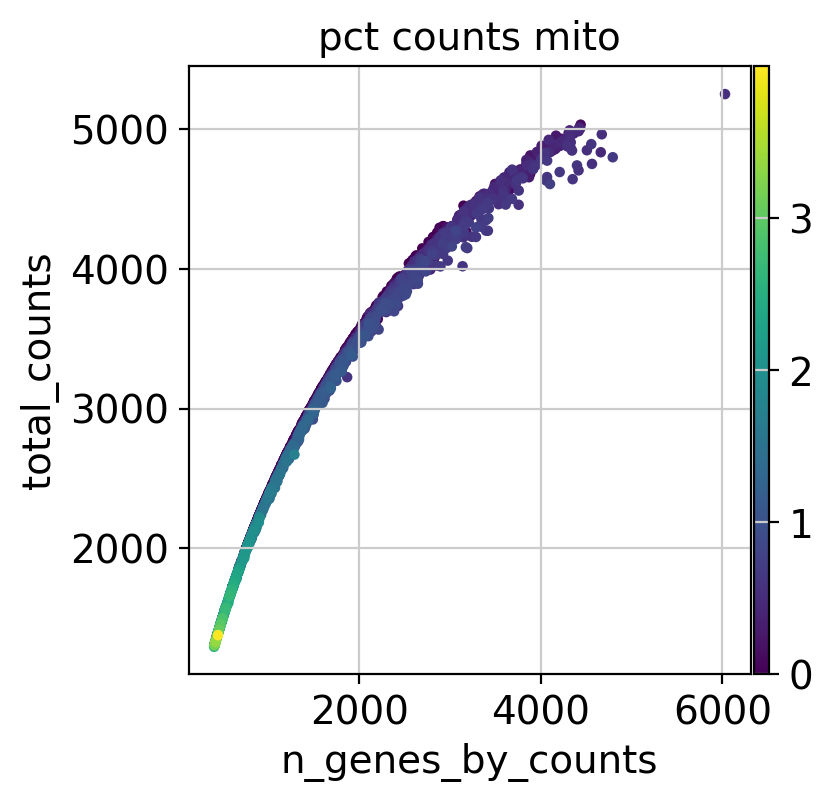

CAF


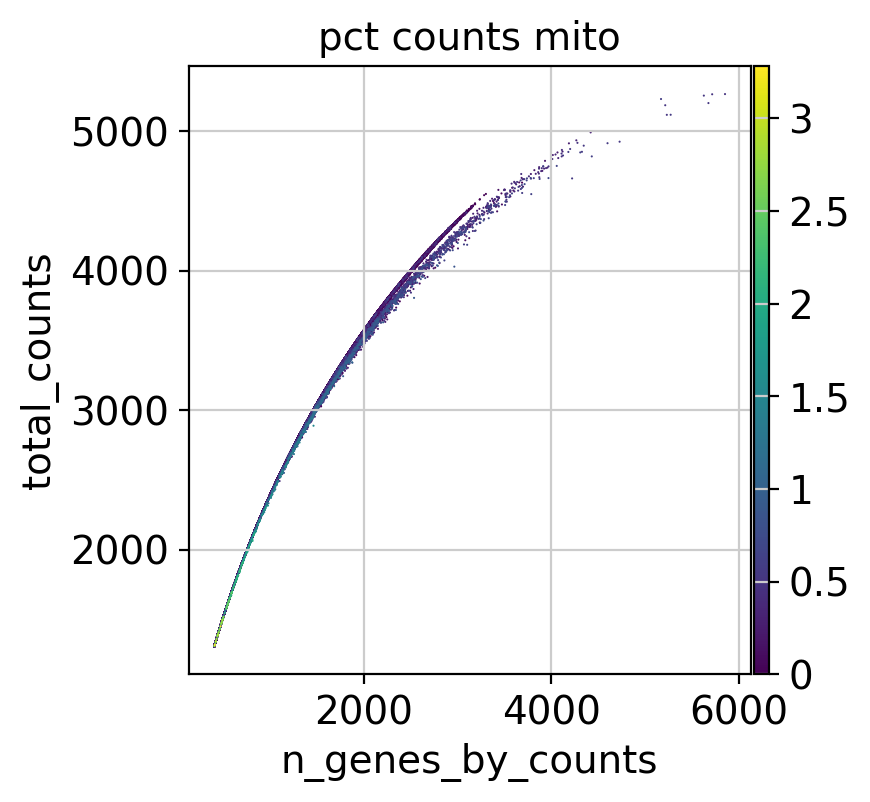

ENDOCRINE CELL


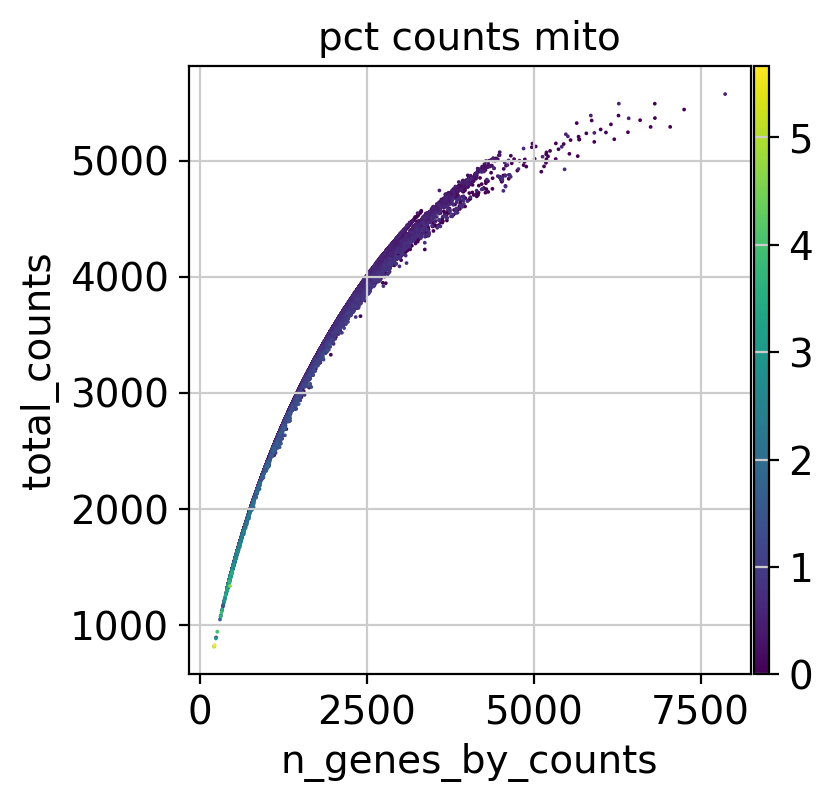

EPITHELIAL CELL


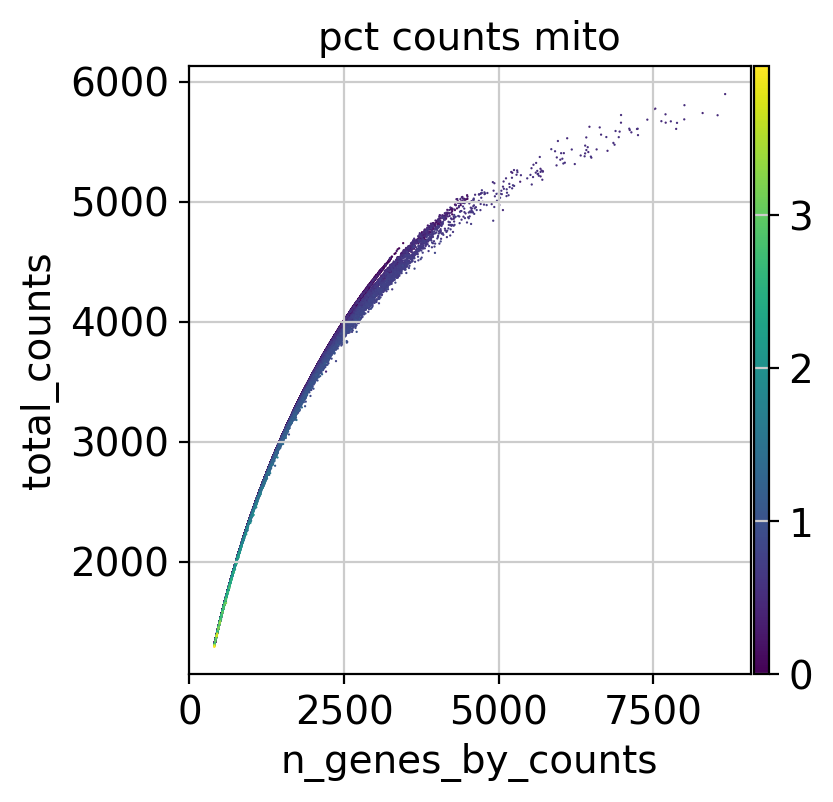

ACINAR CELL


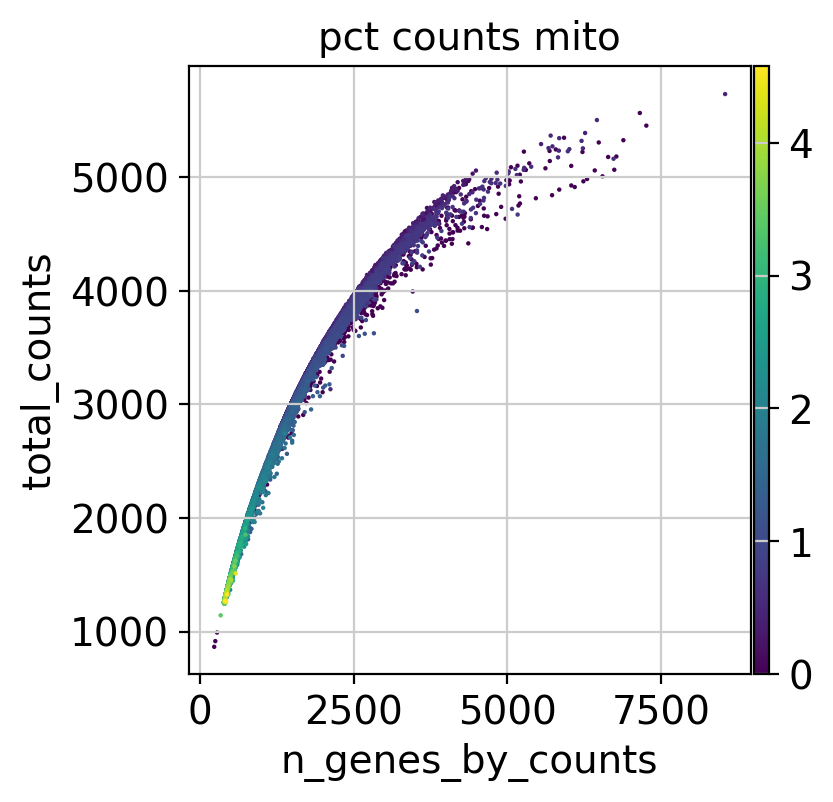

INTRA-PANCREATIC NEURONS


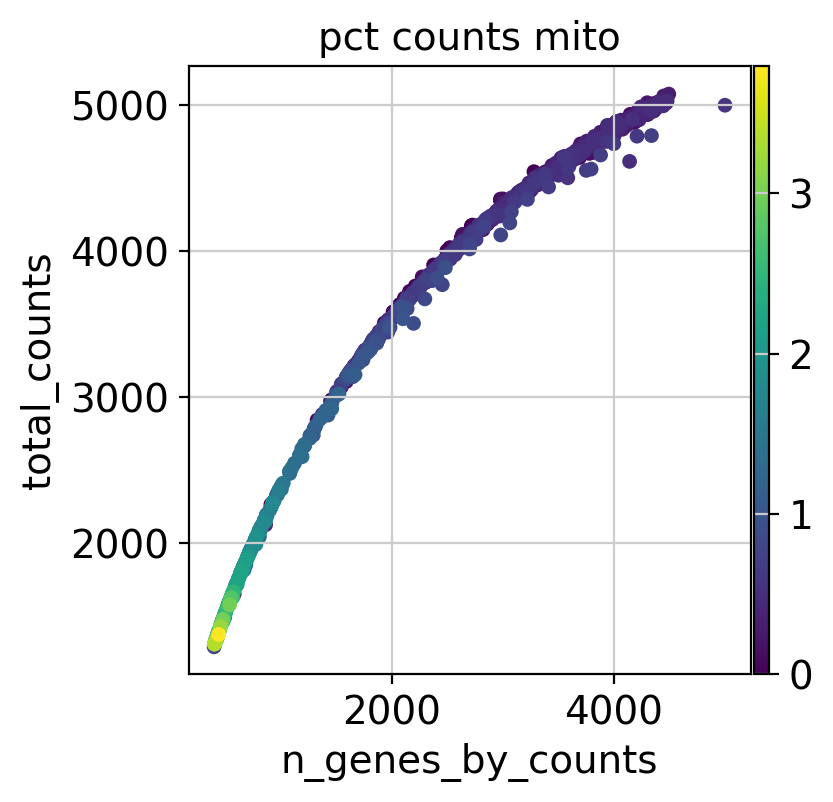

SMOOTH MUSCLE CELL


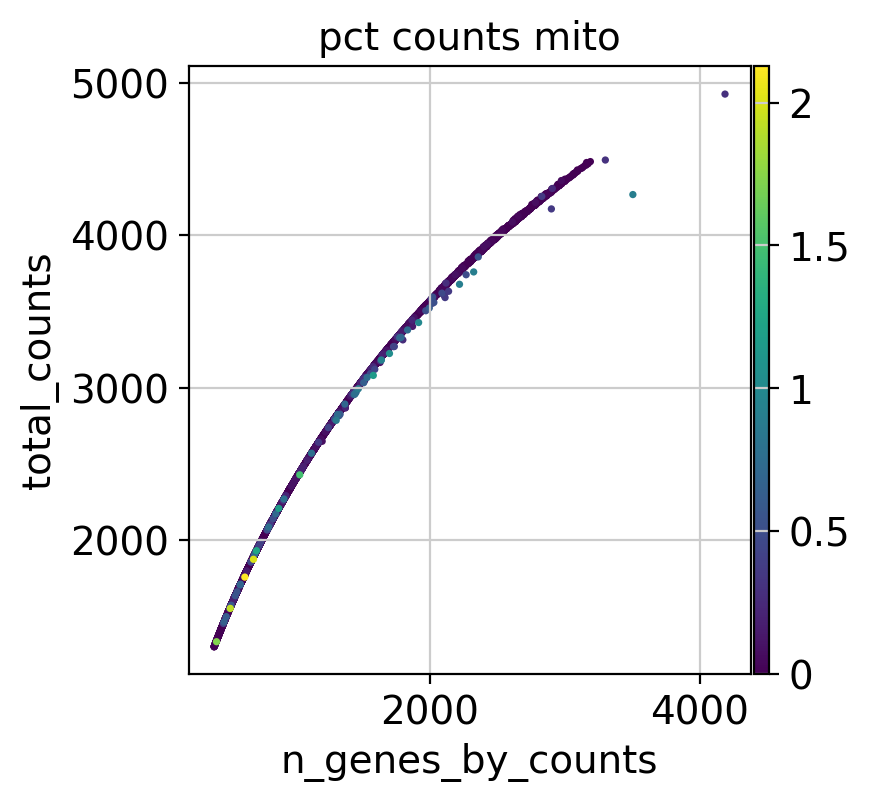

In [65]:
for cell in cell_types:
    adata = ref[ref.obs.scpoli_labels == cell]
    print(cell.upper())
    sc.pl.scatter(
        adata,
        "n_genes_by_counts", "total_counts", color= "pct_counts_mito")

MYELOID CELL


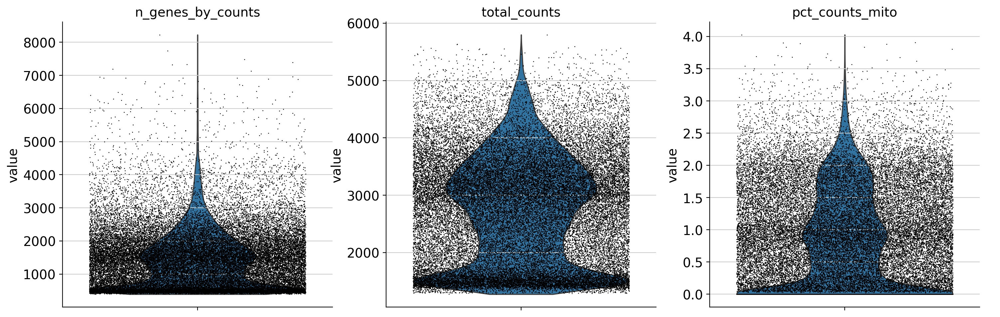

FIBROBLAST


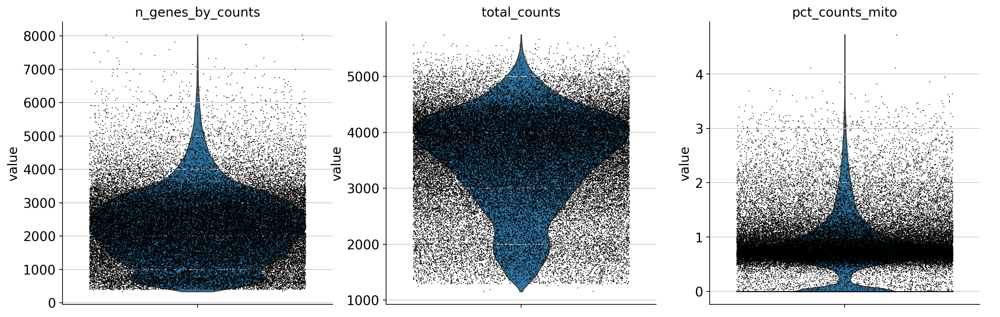

T CELL


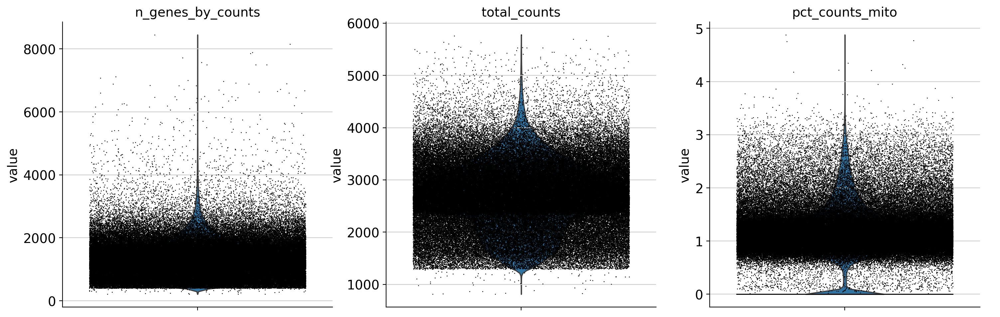

MACROPHAGE


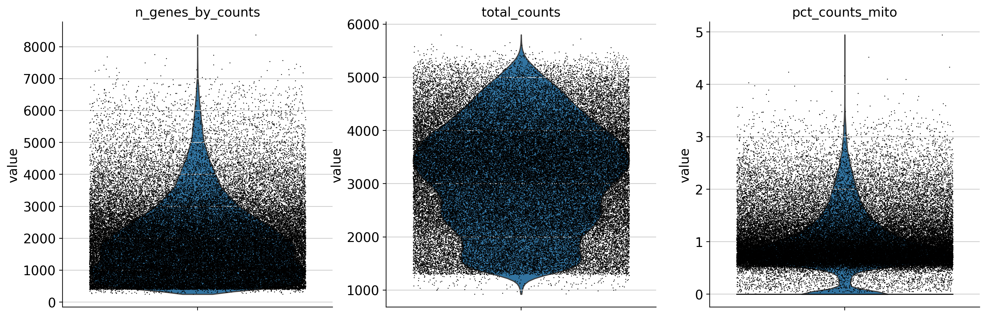

NATURAL KILLER


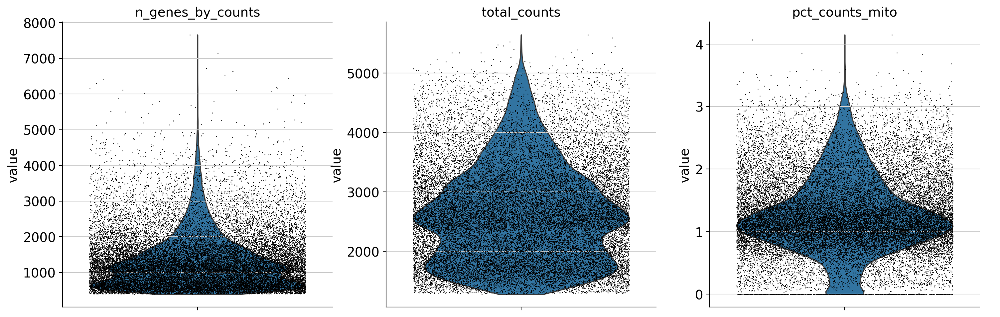

DUCTAL CELL


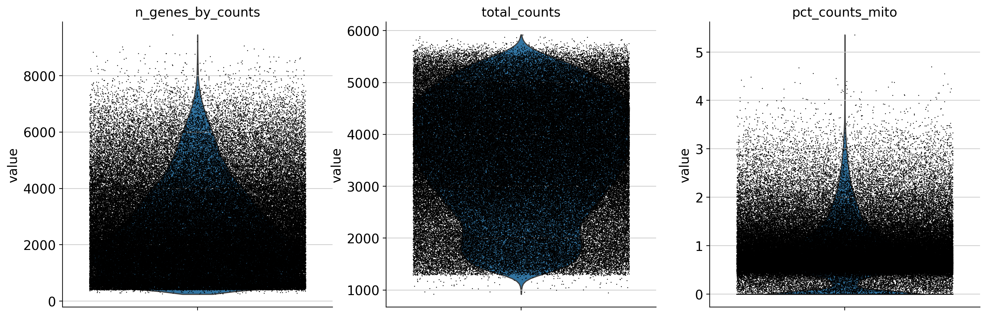

ENDOTHELIAL CELL


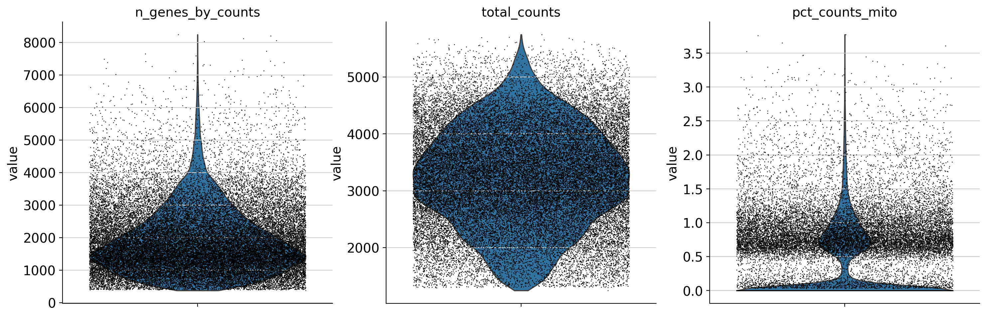

STELLATE CELL


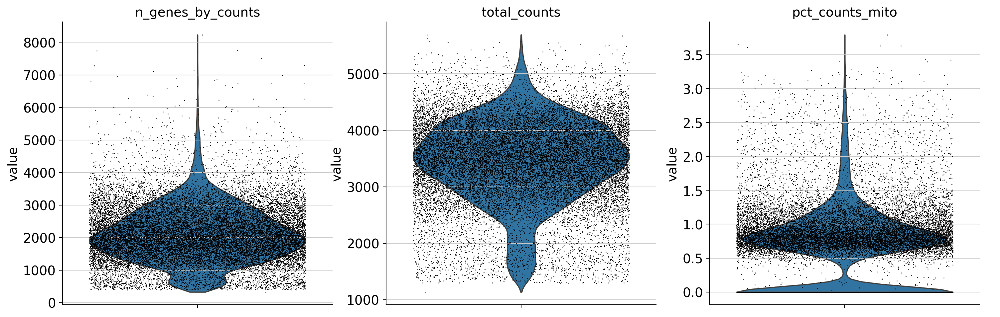

B CELL


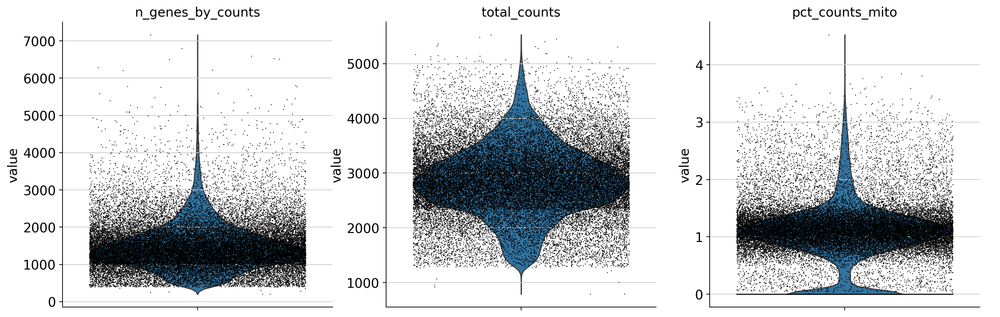

MALIGNANT EPITHELIAL CELL


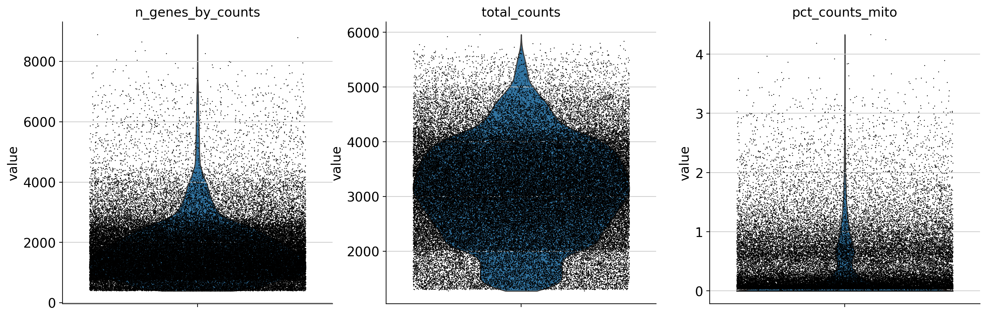

PERICYTE


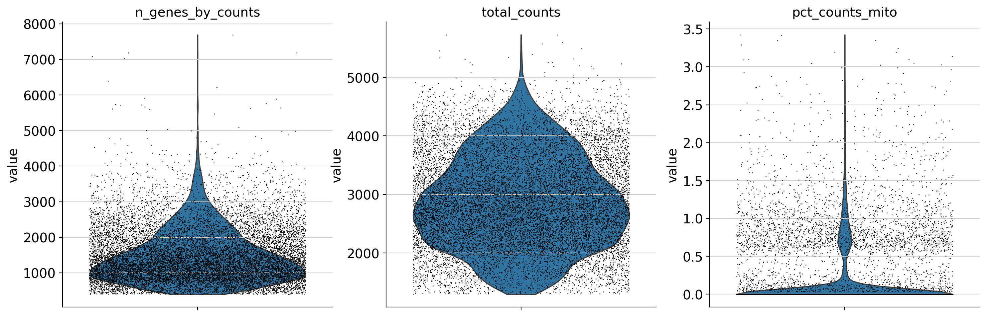

SCHWANN CELL


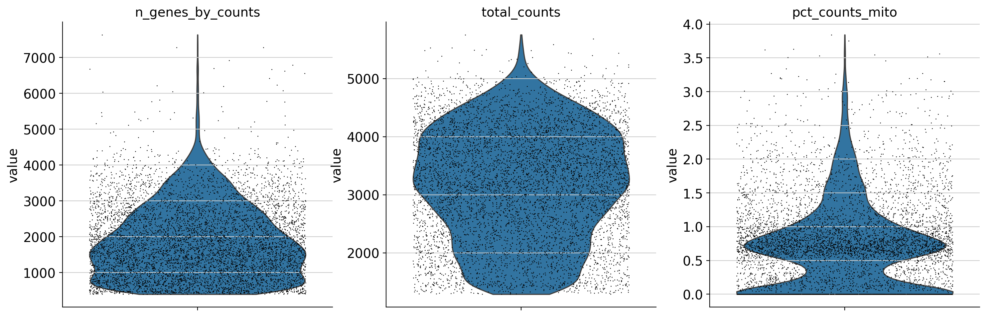

ADIPOCYTE


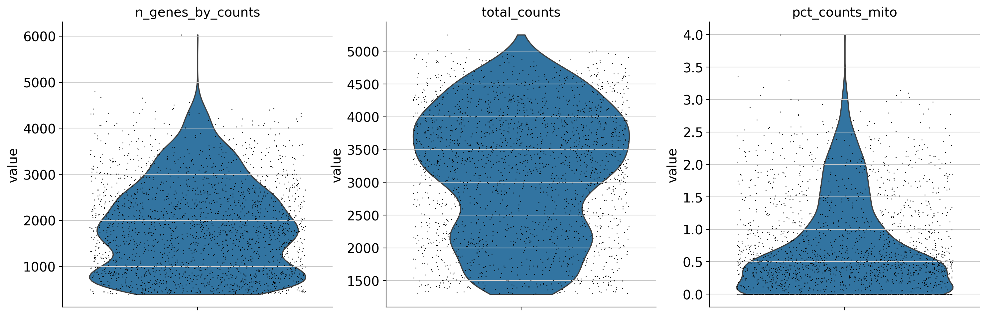

CAF


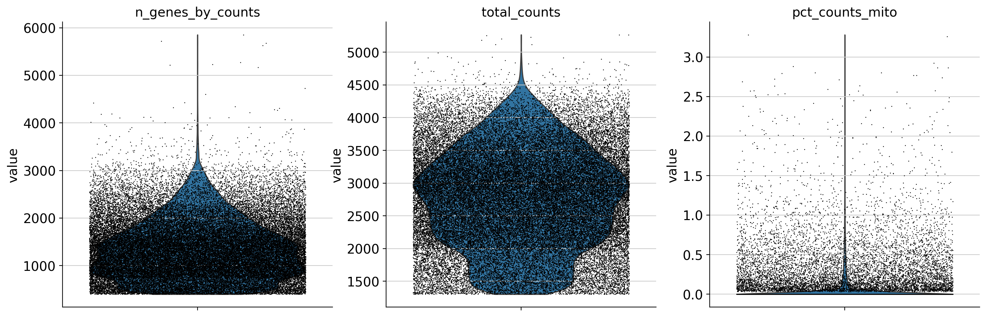

ENDOCRINE CELL


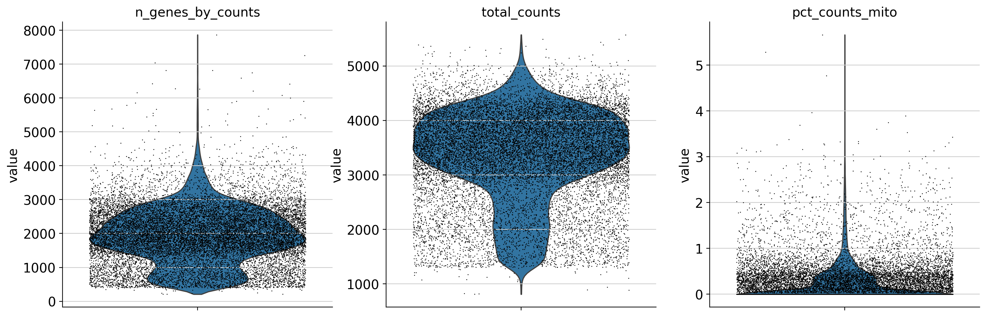

EPITHELIAL CELL


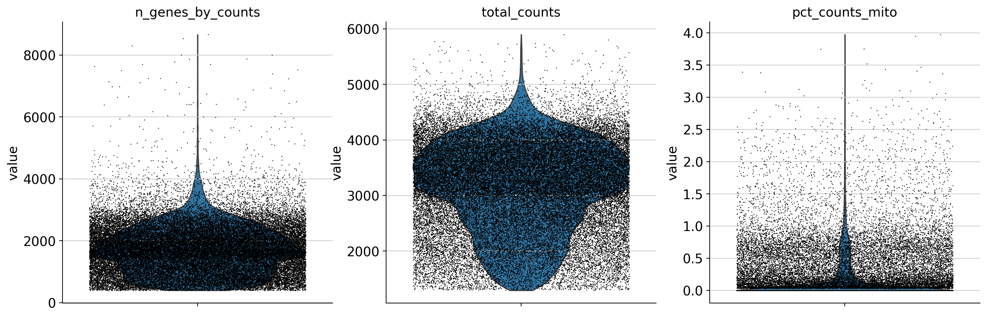

ACINAR CELL


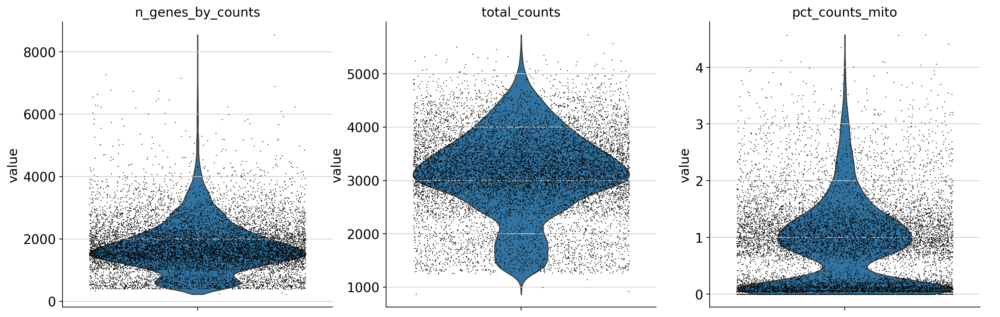

INTRA-PANCREATIC NEURONS


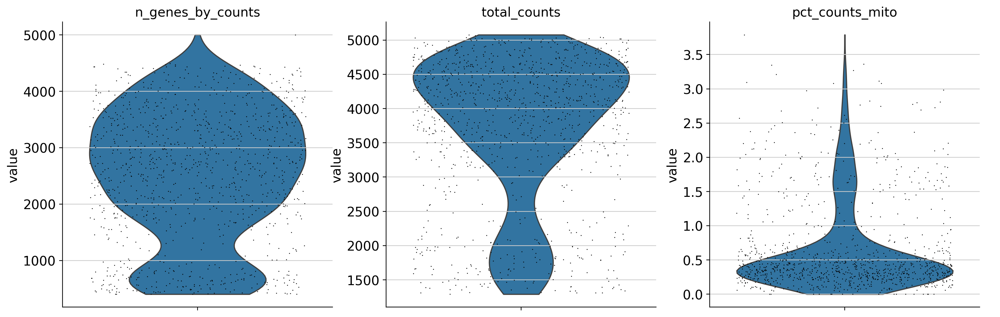

SMOOTH MUSCLE CELL


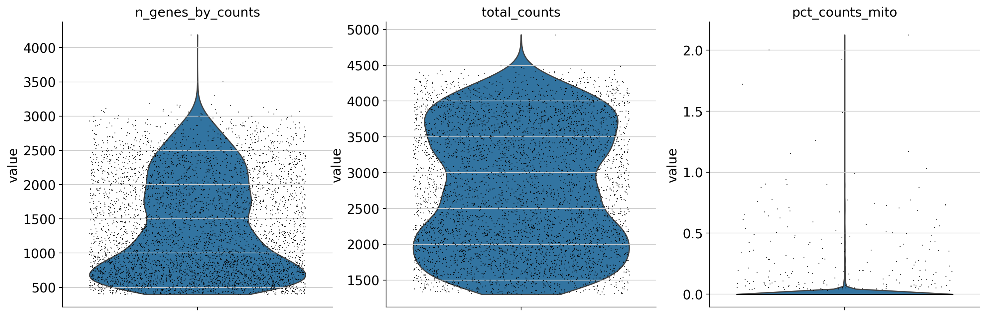

In [64]:
for cell in cell_types:
    adata = ref[ref.obs.scpoli_labels == cell]
    print(cell.upper())
    sc.pl.violin(
        adata,
        ["n_genes_by_counts", "total_counts", "pct_counts_mito"],
        jitter=0.4,
        multi_panel=True,
        ax=axs  
    )
    plt.show()

In [67]:
# def is_outlier(adata, metric: str, nmads: int):
#     M = adata.obs[metric]
#     outlier = (M < np.median(M) - nmads * median_abs_deviation(M)) | (
#         np.median(M) + nmads * median_abs_deviation(M) < M
#     )
#     return outlier

def is_outlier(data, nmads=5):
    median = np.median(data)
    mad = median_abs_deviation(data)
    return (data < median - nmads * mad) | (data > median + nmads * mad)

In [55]:
adata.obs['is_outlier_total_counts'] = is_outlier(adata, "total_counts", 2.5)

In [68]:
ref.obs['outlier'] = False
for dataset in ref.obs['Dataset'].unique():
    for cell in ref.obs.loc[ref.obs['Dataset'] == dataset, 'scpoli_labels'].unique():
        cell_mask = (ref.obs['Dataset'] == dataset) & (ref.obs['scpoli_labels'] == cell)
        total_outliers = pd.Series(False, index=ref.obs.index)
        outlier_total_counts = is_outlier(ref.obs.loc[cell_mask, 'log1p_total_counts'], 5)
        outlier_n_genes = is_outlier(ref.obs.loc[cell_mask, 'log1p_n_genes_by_counts'], 5)
        outlier_mito = is_outlier(ref.obs.loc[cell_mask, 'pct_counts_mito'], 5)
        combined_outlier = outlier_total_counts | outlier_n_genes | outlier_mito
        ref.obs.loc[cell_mask, 'outlier'] |= combined_outlier


In [69]:
ref.obs.outlier.value_counts()

False    784208
True      53775
Name: outlier, dtype: int64

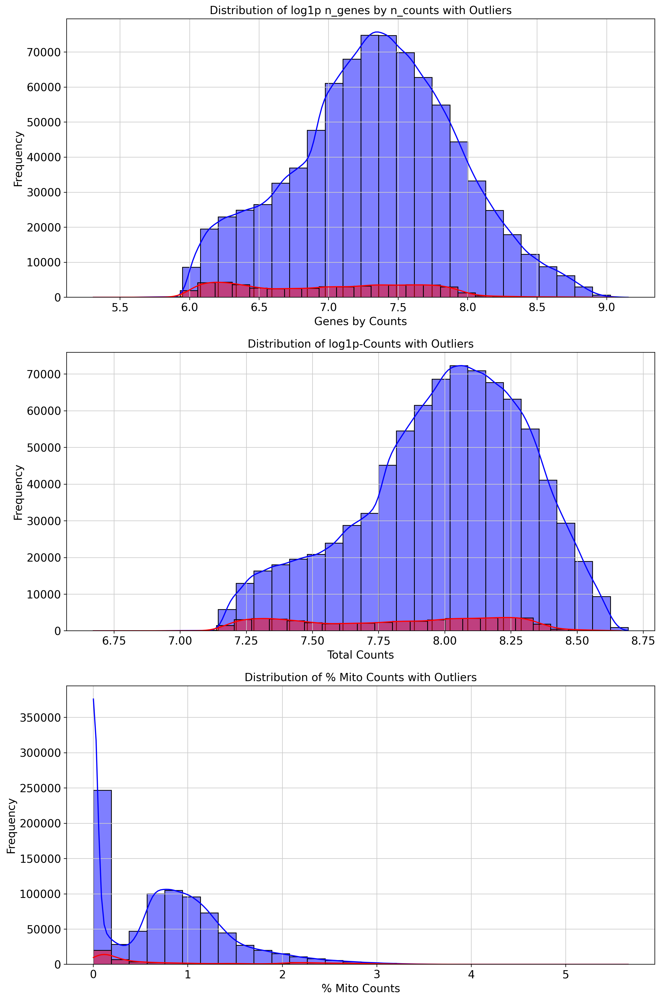

In [121]:
fig, (ax1, ax2, ax3) = plt.subplots(3, 1,figsize=(12, 18))
# plt.figure()
sns.histplot(ref.obs['log1p_n_genes_by_counts'], bins=30, kde=True, color="blue", label='Data', ax=ax1)
sns.histplot(ref.obs.loc[ref.obs['outlier'], 'log1p_n_genes_by_counts'], bins=30, kde=True, color="red", label='Outliers', ax=ax1)
ax1.set_xlabel('Genes by Counts')
ax1.set_ylabel('Frequency')
ax1.set_title('Distribution of log1p n_genes by n_counts with Outliers')

sns.histplot(ref.obs['log1p_total_counts'], bins=30, kde=True, color="blue", label='Data', ax=ax2)
sns.histplot(ref.obs.loc[ref.obs['outlier'], 'log1p_total_counts'], bins=30, kde=True, color="red", label='Outliers', ax=ax2)
ax2.set_xlabel('Total Counts')
ax2.set_ylabel('Frequency')
ax2.set_title('Distribution of log1p-Counts with Outliers')

sns.histplot(ref.obs['pct_counts_mito'], bins=30, kde=True, color="blue", label='Data', ax=ax3)
sns.histplot(ref.obs.loc[ref.obs['outlier'], 'pct_counts_mito'], bins=30, kde=True, color="red", label='Outliers', ax=ax3)
ax3.set_xlabel('% Mito Counts')
ax3.set_ylabel('Frequency')
ax3.set_title('Distribution of % Mito Counts with Outliers')

plt.tight_layout()
plt.show()

In [95]:
size_filtered = ref[~ref.obs.outlier].obs.groupby('scpoli_labels').size()
size_unfiltered = ref.obs.groupby('scpoli_labels').size()

In [99]:
df = pd.DataFrame({
    'Unfiltered': size_unfiltered,
    'Filtered': size_filtered
})
df['Cells_Removed'] = df.Unfiltered - df.Filtered

In [110]:
df.sort_values(by='Cells_Removed', ascending=False)

,Unfiltered,Filtered,Cells_Removed
scpoli_labels,,,
Malignant Epithelial Cell,78928,61261,17667
Ductal Cell,157458,151443,6015
Epithelial Cell,44805,39006,5799
CAF,52319,47947,4372
Myeloid Cell,42966,39090,3876
Macrophage,71399,68170,3229
T Cell,158496,155547,2949
Endothelial Cell,38758,36372,2386
Fibroblast,55696,53389,2307


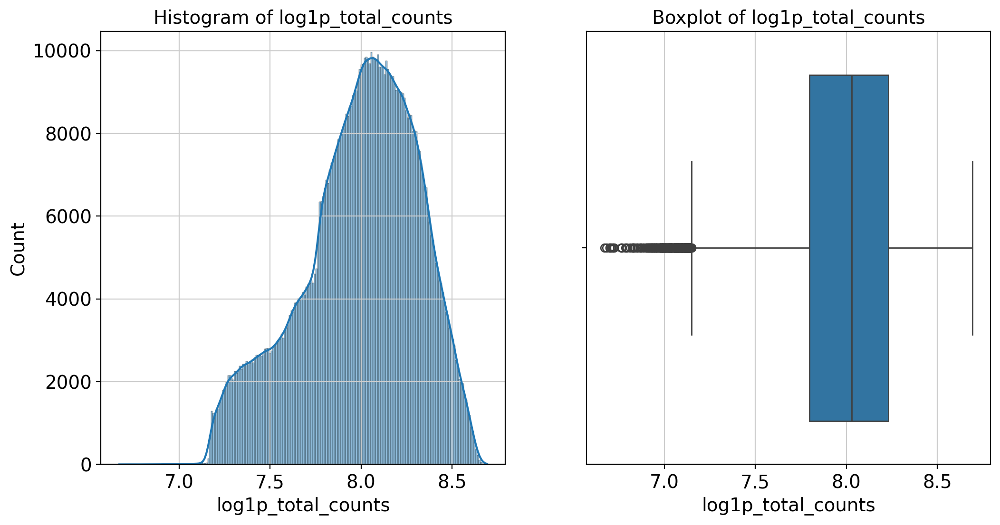

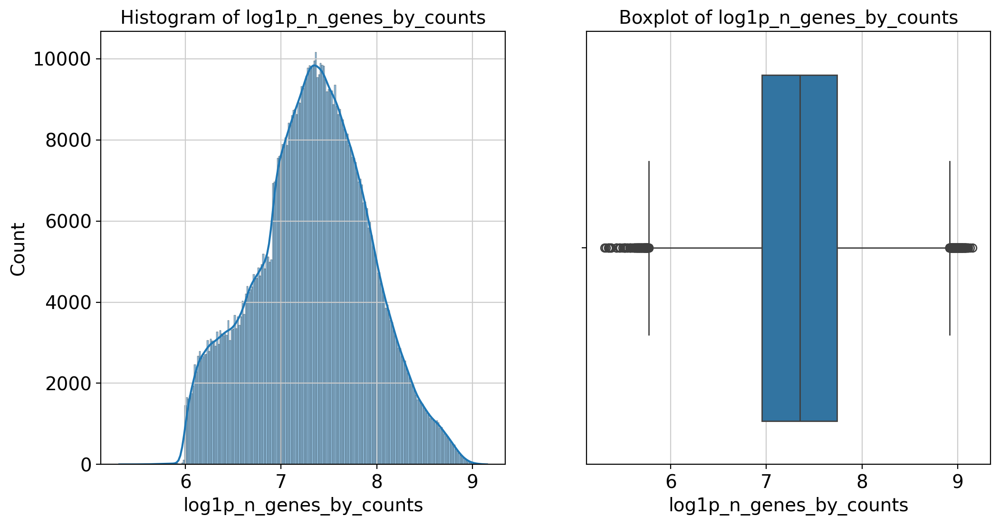

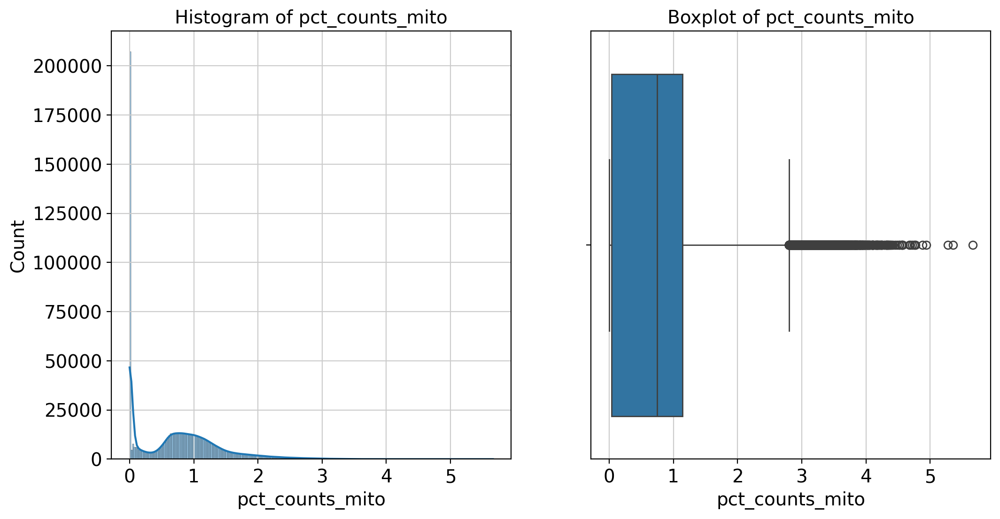

In [106]:
for metric in ['log1p_total_counts', 'log1p_n_genes_by_counts', 'pct_counts_mito']:
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    sns.histplot(ref.obs[metric], kde=True)
    plt.title(f'Histogram of {metric}')
    plt.subplot(1, 2, 2)
    sns.boxplot(x=ref.obs[metric])
    plt.title(f'Boxplot of {metric}')
    plt.show()

In [105]:
nmad_values = list(range(0,11))
outlier_summary = {}
for nmad in nmad_values:
    for metric in ['log1p_total_counts', 'log1p_n_genes_by_counts', 'pct_counts_mito']:
        outliers = is_outlier(ref.obs[metric], nmad)
        key = f'{metric}_NMAD_{nmad}'
        outlier_summary[key] = outliers.mean() * 100  
pd.DataFrame(outlier_summary, index=['Percentage of Outliers']).T


,Percentage of Outliers
log1p_total_counts_NMAD_0,99.999881
log1p_n_genes_by_counts_NMAD_0,99.954056
pct_counts_mito_NMAD_0,99.999881
log1p_total_counts_NMAD_1,49.999940
log1p_n_genes_by_counts_NMAD_1,49.979415
pct_counts_mito_NMAD_1,49.999940
log1p_total_counts_NMAD_2,18.483907
log1p_n_genes_by_counts_NMAD_2,20.222487
pct_counts_mito_NMAD_2,7.408384
log1p_total_counts_NMAD_3,5.523859


In [145]:
ref.obs['outlier'] = False
skip_list = ['Malignant Epithelial Cell', 'Ductal Cell', 'Acinar cell']
for dataset in ref.obs['Dataset'].unique():
    for cell in ref.obs.loc[ref.obs['Dataset'] == dataset, 'scpoli_labels'].unique():
        if cell in skip_list:
            print(f'Skipping for {cell} in {dataset}')
            continue
        cell_mask = (ref.obs['Dataset'] == dataset) & (ref.obs['scpoli_labels'] == cell)
        total_outliers = pd.Series(False, index=ref.obs.index)
        outlier_total_counts = is_outlier(ref.obs.loc[cell_mask, 'log1p_total_counts'], 5)
        outlier_n_genes = is_outlier(ref.obs.loc[cell_mask, 'log1p_n_genes_by_counts'], 5)
        outlier_mito = is_outlier(ref.obs.loc[cell_mask, 'pct_counts_mito'], 5)
        combined_outlier = outlier_total_counts | outlier_n_genes | outlier_mito
        ref.obs.loc[cell_mask, 'outlier'] |= combined_outlier

Skipping for Ductal Cell in Ding
Skipping for Malignant Epithelial Cell in Ding
Skipping for Acinar cell in Ding
Skipping for Acinar cell in Lee
Skipping for Ductal Cell in Lee
Skipping for Malignant Epithelial Cell in Lee
Skipping for Malignant Epithelial Cell in Regev
Skipping for Ductal Cell in Simeone
Skipping for Malignant Epithelial Cell in Simeone
Skipping for Acinar cell in Simeone
Skipping for Malignant Epithelial Cell in Steele
Skipping for Ductal Cell in Steele
Skipping for Acinar cell in Steele
Skipping for Ductal Cell in Peng
Skipping for Acinar cell in Peng
Skipping for Malignant Epithelial Cell in Caronni
Skipping for Ductal Cell in Caronni
Skipping for Acinar cell in Caronni
Skipping for Ductal Cell in Zhang
Skipping for Malignant Epithelial Cell in Zhang
Skipping for Acinar cell in Zhang
Skipping for Ductal Cell in Moncada
Skipping for Acinar cell in Moncada
Skipping for Ductal Cell in Schlesinger
Skipping for Acinar cell in Schlesinger
Skipping for Ductal Cell in Zeno

In [146]:
size_filtered = ref[~ref.obs.outlier].obs.groupby('scpoli_labels').size()
size_unfiltered = ref.obs.groupby('scpoli_labels').size()
df = pd.DataFrame({
    'Unfiltered': size_unfiltered,
    'Filtered': size_filtered
})
df['Cells_Removed'] = df.Unfiltered - df.Filtered
df.loc["Total"] = df.sum()
df

,Unfiltered,Filtered,Cells_Removed
scpoli_labels,,,
Acinar cell,11820,11820,0
Adipocyte,2087,2023,64
B cell,35533,34298,1235
CAF,52319,47947,4372
Ductal Cell,157458,157458,0
Endocrine Cell,16410,14274,2136
Endothelial Cell,38758,36372,2386
Epithelial Cell,44805,39006,5799
Fibroblast,55696,53389,2307


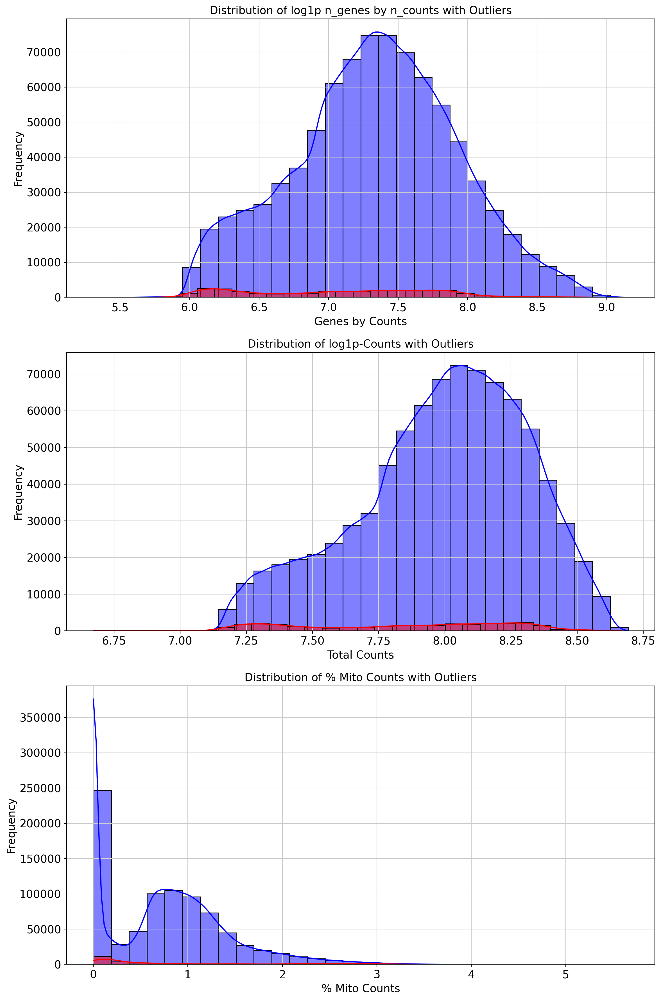

In [147]:
fig, (ax1, ax2, ax3) = plt.subplots(3, 1,figsize=(12, 18))
# plt.figure()
sns.histplot(ref.obs['log1p_n_genes_by_counts'], bins=30, kde=True, color="blue", label='Data', ax=ax1)
sns.histplot(ref.obs.loc[ref.obs['outlier'], 'log1p_n_genes_by_counts'], bins=30, kde=True, color="red", label='Outliers', ax=ax1)
ax1.set_xlabel('Genes by Counts')
ax1.set_ylabel('Frequency')
ax1.set_title('Distribution of log1p n_genes by n_counts with Outliers')

sns.histplot(ref.obs['log1p_total_counts'], bins=30, kde=True, color="blue", label='Data', ax=ax2)
sns.histplot(ref.obs.loc[ref.obs['outlier'], 'log1p_total_counts'], bins=30, kde=True, color="red", label='Outliers', ax=ax2)
ax2.set_xlabel('Total Counts')
ax2.set_ylabel('Frequency')
ax2.set_title('Distribution of log1p-Counts with Outliers')

sns.histplot(ref.obs['pct_counts_mito'], bins=30, kde=True, color="blue", label='Data', ax=ax3)
sns.histplot(ref.obs.loc[ref.obs['outlier'], 'pct_counts_mito'], bins=30, kde=True, color="red", label='Outliers', ax=ax3)
ax3.set_xlabel('% Mito Counts')
ax3.set_ylabel('Frequency')
ax3.set_title('Distribution of % Mito Counts with Outliers')

plt.tight_layout()
plt.show()

In [149]:
ref.write('../Classifier/scpoli_donor_final_integration_all_genes.h5ad')